<a href="https://colab.research.google.com/github/rsakml/PCVK_Genap_2022/blob/main/UTS_Lia_Rossa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive

# Accessing My Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import pandas as pd
import cv2 as cv
from google.colab.patches import cv2_imshow #for image display
from skimage import transform
import matplotlib.pyplot as plt
import glob
import math

resolusi image: tinggi x lebar =  360  x  480


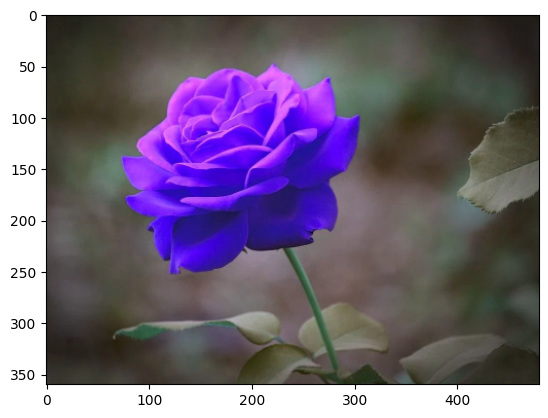

In [ ]:
img = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')
img = cv.resize(img, (0,0), fx=0.5, fy=0.5)
tinggi = img.shape[0]
lebar = img.shape[1]
print("resolusi image: tinggi x lebar = ", tinggi," x ",lebar)
plt.imshow(img)

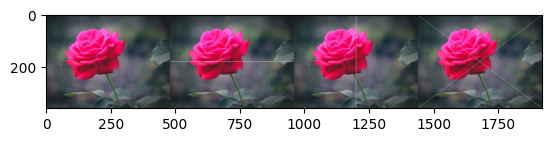

In [ ]:
img2 = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img3 = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img4 = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img5 = cv.cvtColor(img, cv.COLOR_BGR2RGB)

#membuat garis horizontal ditengah image
for y in range (lebar):
  img3[int((tinggi)/2),y] = [255,255,255]

#membuat garis vertikal ditengah image
for y in range (tinggi):
  img4[y, int((lebar)/2)] = [255,255,255]

#membuat garis silang ditengah image
for x in range (tinggi):
  img5[x,int(x*(lebar/tinggi))] = [255,255,255]
  img5[x,lebar-1-int(x*(lebar/tinggi))] = [255,255,255]

final_frame = cv.hconcat((img2, img3, img4, img5))
plt.imshow(final_frame)

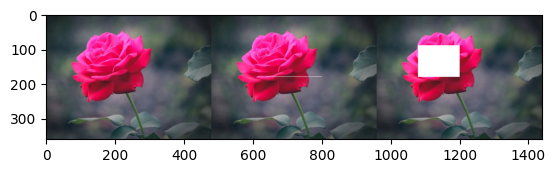

In [ ]:
img6 = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img7 = cv.cvtColor(img, cv.COLOR_BGR2RGB)

# membuat garis ditengah
garis_awal = (int(lebar/2) - 80, int(tinggi/2))
garis_akhir = (int(lebar/2) + 80, int(tinggi/2))

cv.line(img6, garis_awal, garis_akhir, (255,255,255), 1)

# membuat kotak
garis_awal = (int(lebar/4), int(tinggi/4))
garis_akhir = (int(2 * lebar/4), int(2*tinggi/4))
color = (255, 255, 255)
thickness = -1

cv.rectangle(img7, garis_awal, garis_akhir, color, thickness)

final_frame = cv.hconcat((img2, img6, img7))
plt.imshow(final_frame)

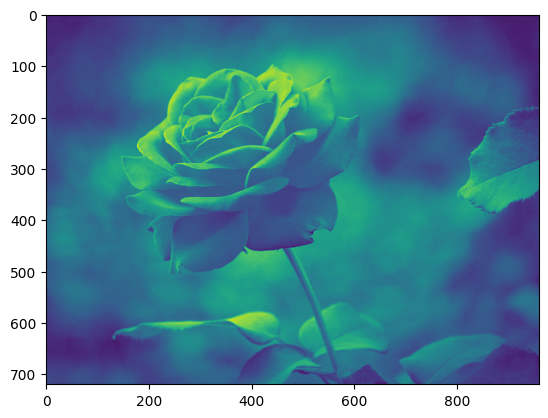

In [ ]:
img_gray = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg', cv.IMREAD_GRAYSCALE)
plt.imshow(img_gray)

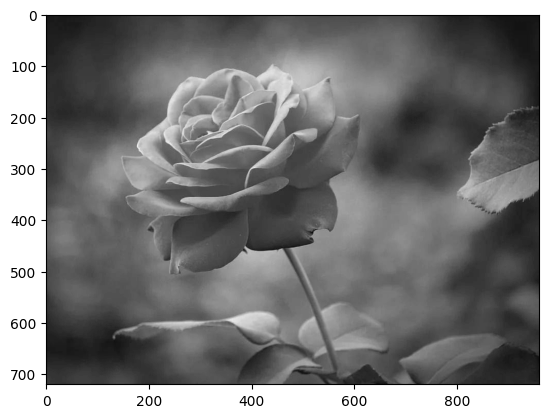

In [ ]:
plt.imshow(img_gray, cmap='gray')

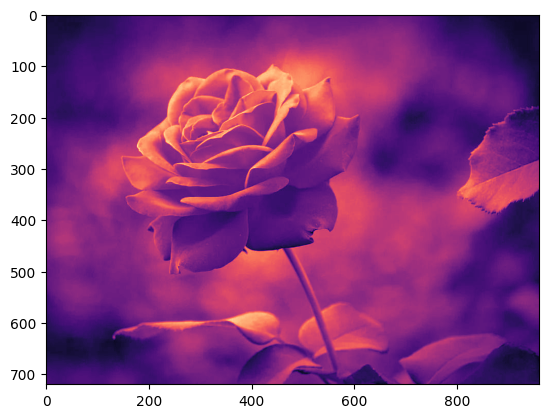

In [ ]:
plt.imshow(img_gray, cmap='magma')

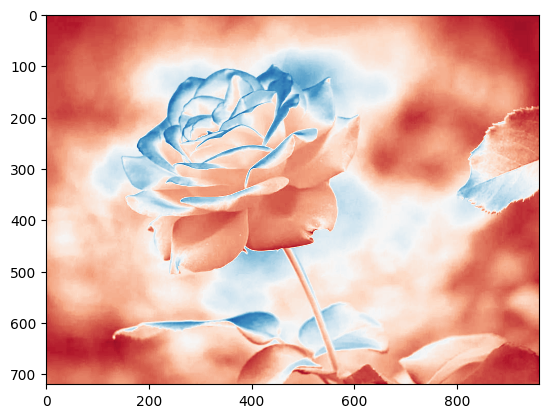

In [ ]:
plt.imshow(img_gray, cmap='RdBu')

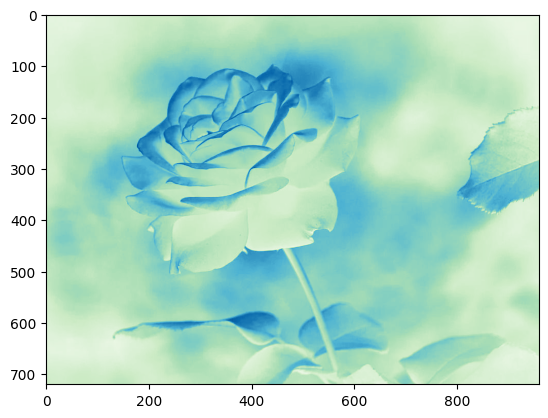

In [ ]:
plt.imshow(img_gray, cmap='GnBu')

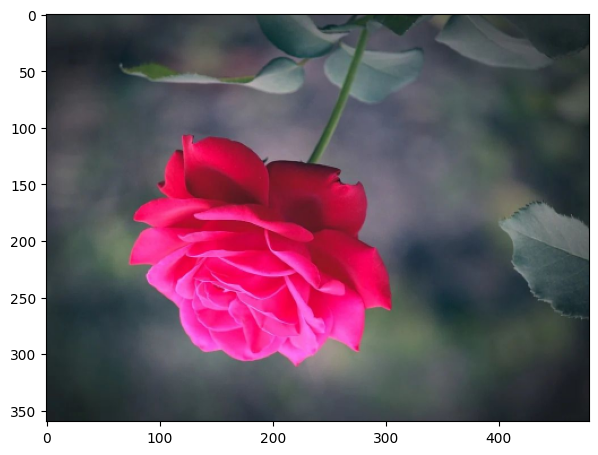

In [ ]:
img8 = cv.flip(cv.cvtColor(img, cv.COLOR_BGR2RGB),0)

#tampilkan plot dengan ukuran canvas yang lebih besar
fig = plt.figure(figsize=(7, 7)) 
ax = fig.add_subplot(111)
ax.imshow(img8)

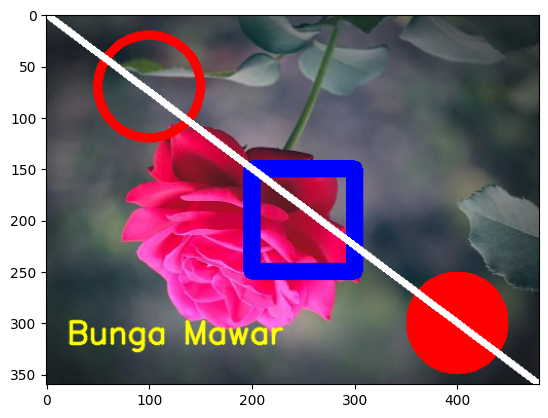

In [ ]:
cv.rectangle(img8,pt1=(200,150),pt2=(300,250),color=(0,0,255),thickness=15)
cv.circle(img8,center=(100,70),radius=50,color=(255,0,0),thickness=8)
cv.circle(img8,center=(400,300),radius=50,color=(255,0,0),thickness=-1)
cv.line(img8,pt1=(0,0),pt2=(480,360),color=(255,255,255),thickness=5)

font = cv.FONT_HERSHEY_SIMPLEX
cv.putText(img8,text='Bunga Mawar',org=(20,320),fontFace=font,fontScale=1,color=(255,255,0),thickness=2,lineType=cv.LINE_AA)

plt.imshow(img8)

**Transformasi Linier Brightness**

In [3]:
original = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg') # get image from gdrive

Mengubah tingkat kecerahan citra
--------------------------------
Masukkan nilai kecerahan: 60


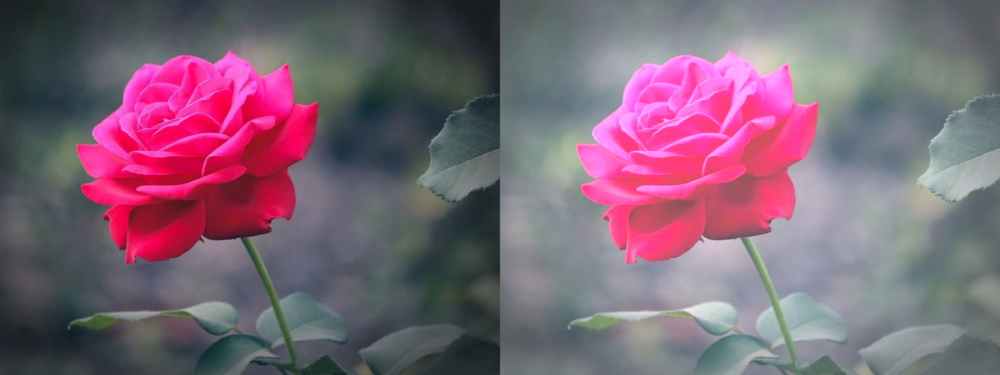

In [ ]:
print('Mengubah tingkat kecerahan citra')
print('--------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')

brightness_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

Mengubah kontras dan tingkat kecerahan citra
--------------------------------------------
Masukkan nilai kecerahan [-255 - 255]: 60
Masukkan kontras [1.0 - 3.0]: 1.5


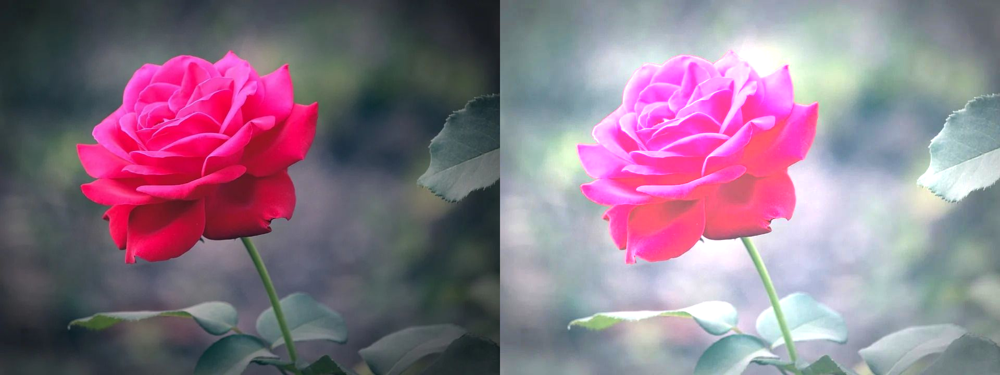

In [4]:
print('Mengubah kontras dan tingkat kecerahan citra')
print('--------------------------------------------')
try :
  brightness = int(input('Masukkan nilai kecerahan [-255 - 255]: '))
  contrast = float(input('Masukkan kontras [1.0 - 3.0]: '))
except ValueError:
  print('Error, not a number')

contrast_image = np.zeros(original.shape, original.dtype)

# akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      contrast_image[y,x,c] = np.clip(contrast*original[y,x,c] + brightness, 0, 255)


final_frame = cv.hconcat((original, contrast_image))
cv2_imshow(final_frame)

 Mengubah tingkat kecerahan citra dengan Transformasi Log 
----------------------------------------------------------
Masukan nilai kecerahan: 40


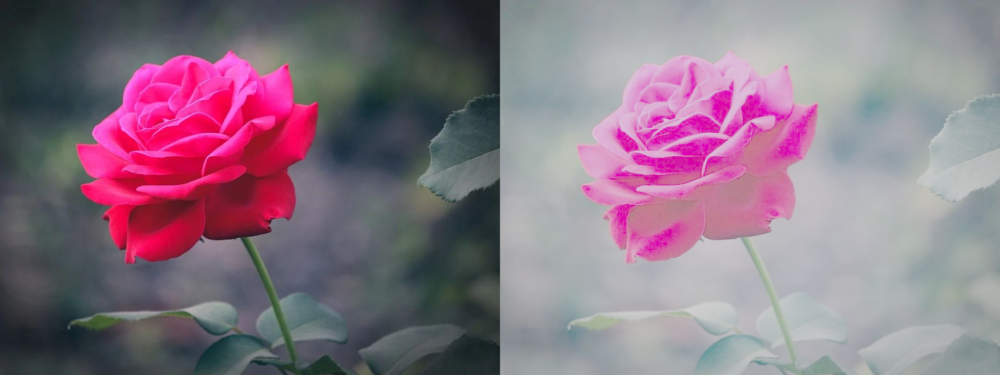

In [ ]:
print(' Mengubah tingkat kecerahan citra dengan Transformasi Log ')
print('----------------------------------------------------------')

try:
  brightness = int(input('Masukan nilai kecerahan: '))
except ValueError:
  input('Error, not a number')

brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(brightness * (np.log(1 + original[y,x,c])), 0 , 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

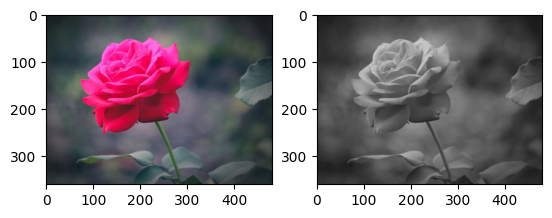

In [ ]:
# a. Averaging

img_avg = img
img_avg[:] = img_avg.mean(axis=-1, keepdims=1)
fig, ax = plt.subplots(1,2)
ax[0].imshow(img2)
ax[1].imshow(img_avg)

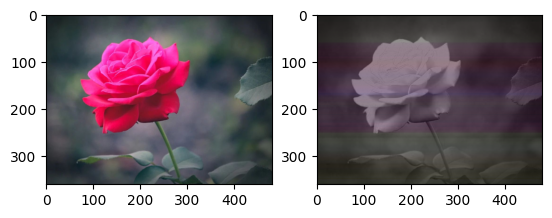

In [ ]:
# b. Lightness

img_lightness = img
img_lightness[:] = np.max(img_lightness,axis=-1, keepdims=100)/2 + np.min(img_lightness,axis=-2, keepdims=100)/2
fig, ax = plt.subplots(1,2)
ax[0].imshow(img2)
ax[1].imshow(img_lightness)

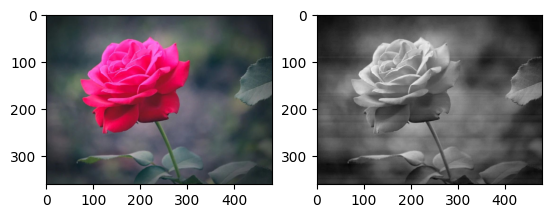

In [ ]:
# c. Luminance

img_luminance = img
R, G, B = img_luminance[:,:,0], img_luminance[:,:,1], img_luminance[:,:,2]
gray_img_luminance = (0.21 * R) + (0.72 * G) + (0.07 * B)
fig, ax = plt.subplots(1,2)
ax[0].imshow(img2)
ax[1].imshow(gray_img_luminance, cmap='gray')

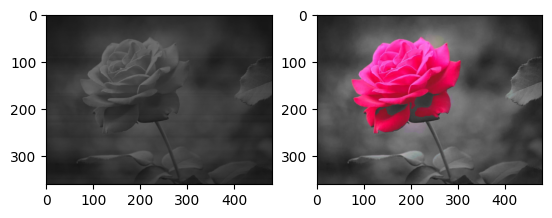

In [ ]:
# menampilkan warna tertentu

temp = np.array(img2)
for y in range(img.shape[0]):
    for x in range(img.shape[1]):
        if (temp[y,x,0] < 130 or temp[y,x,1] > 300):
            temp[y,x]= np.mean(temp[y,x])

fig, ax = plt.subplots(1,2)
ax[0].imshow(img)
ax[1].imshow(temp)

 Gamma Correction pada citra 
----------------------------------
Masukkan nilai Gamma: 4


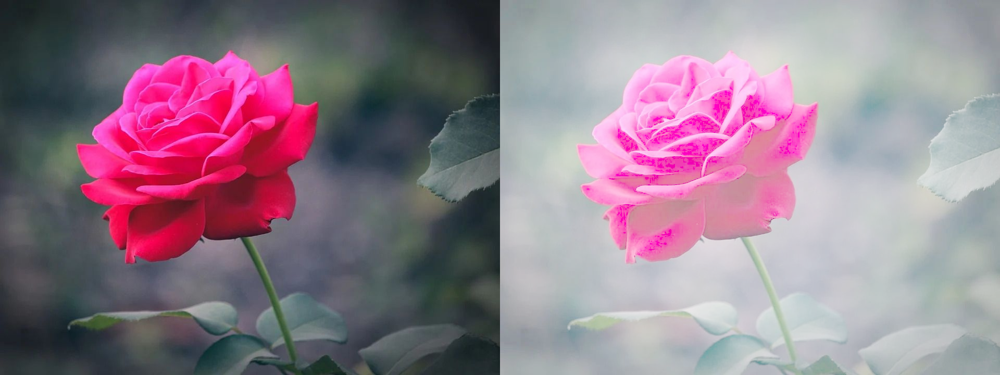

In [ ]:
print(' Gamma Correction pada citra ') 
print('----------------------------------') 
try: 
 gamma = int(input('Masukkan nilai Gamma: ')) 
except ValueError: 
 print('Error, not a number') 

gamma_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      gamma_image[y,x,c] = np.clip(255 * pow(original[y,x,c]/255, (1/gamma)), 0, 255)

final_frame = cv.hconcat((original, gamma_image))
cv2_imshow(final_frame)

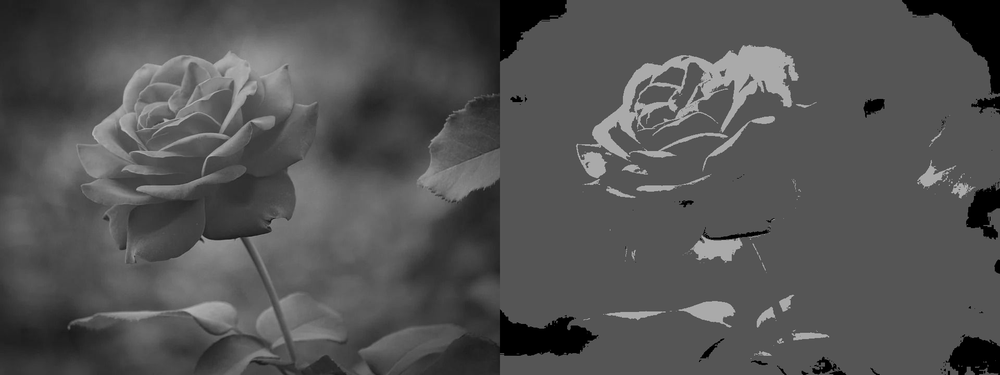

In [ ]:
bit_depth=2
bit = 2**bit_depth
level = 255 / (pow(2,bit_depth)-1) 
original = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg', cv.IMREAD_GRAYSCALE) 
depth_image = np.zeros(original.shape, original.dtype)

#akses per piksel

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
      depth_image[y,x] = np.clip(round(original[y,x] / level) * level, 0, 255)


final_frame = cv.hconcat((original, depth_image))
cv2_imshow(final_frame)

Average Denoising Pada Citra
-------------------------------
Masukkan jumlah citra: 50
19.473719578055885 734.0208614165572


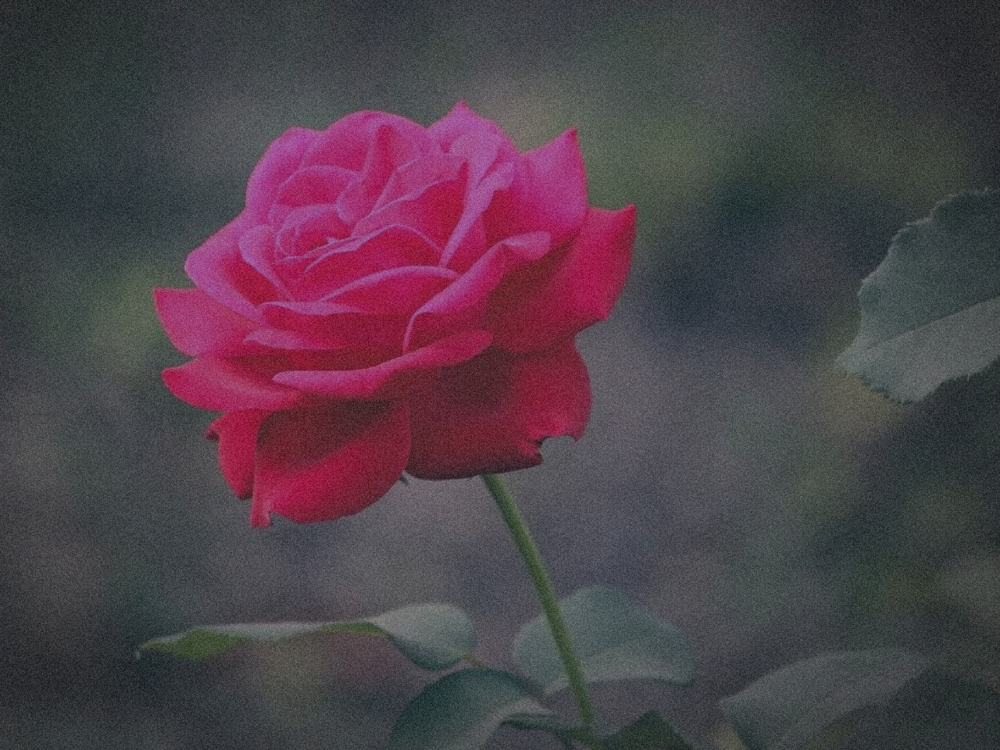

In [ ]:
print('Average Denoising Pada Citra')
print('-------------------------------')

original_image = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_noise.jpg')
cv_img = []
for img in glob.glob('/content/drive/MyDrive/Pengolahan Citra/UTS/noises/*.jpg'): 
  n = cv.imread(img)
  cv_img.append(n)

def PSNR(img1, img2):
  mse = np.mean((img1 - img2) ** 2)
  if(mse == 0): # MSE 0 maka tidak ada noise sama sekali, sehingga PSNR tidak memiliki arti
    return 100
  max_pixel = 255.0
  psnr = 20 * math.log10(max_pixel / math.sqrt(mse))
  return psnr, mse

try:
  jumlah_citra = int(input('Masukkan jumlah citra: '))
except ValueError:
  print('Error, not a number')

noised_image = np.zeros(cv_img[0].shape)
for i in range (jumlah_citra):
  noised_image = noised_image+cv_img[i]

  
noised_image = noised_image / jumlah_citra

psnr, mse = PSNR(original_image, noised_image)
print(psnr, mse)
cv2_imshow(noised_image)

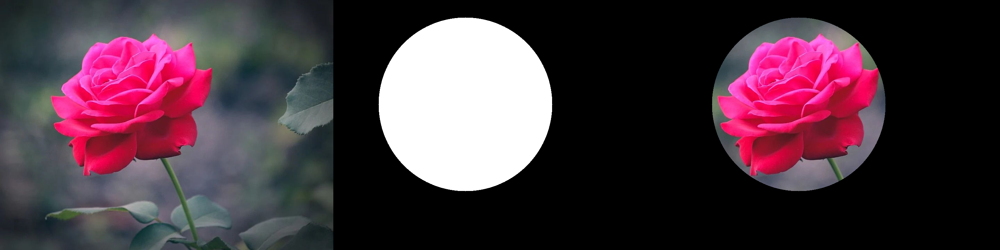

In [ ]:
img_t = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')

mask = np.zeros(img_t.shape, dtype=np.uint8)

mask1 = cv.circle(mask, (380, 300), 250, (255,255,255), -1)

result = img_t & mask1

final_frame = cv.hconcat((img_t, mask, result))
cv2_imshow(final_frame)

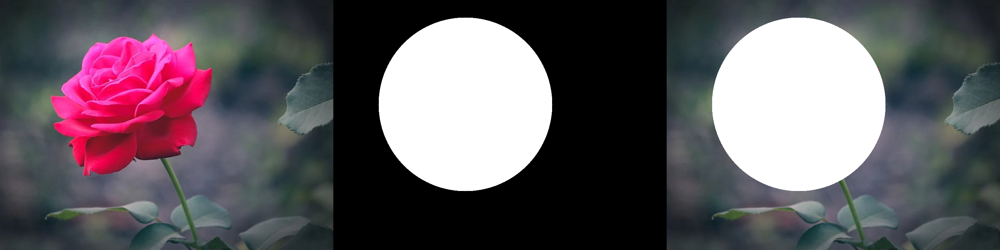

In [ ]:
img_t = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')

mask = np.zeros(img_t.shape, dtype=np.uint8)
mask1 = cv.circle(mask, (380, 300), 250, (255,255,255), -1)

result = img_t | mask1  # menggunakan operator bitwise OR

final_frame = cv.hconcat((img_t, mask, result))
cv2_imshow(final_frame)

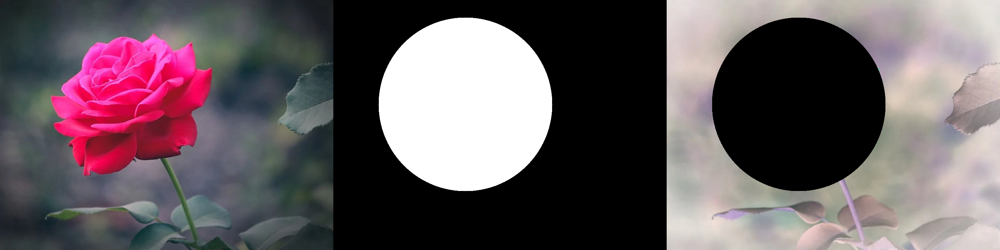

In [ ]:
img_t = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')

mask = np.zeros(img_t.shape, dtype=np.uint8)
mask1 = cv.circle(mask, (380, 300), 250, (255,255,255), -1)

result = ~img_t & ~mask1  # menggunakan operator bitwise NOT

final_frame = cv.hconcat((img_t, mask, result))
cv2_imshow(final_frame)
     

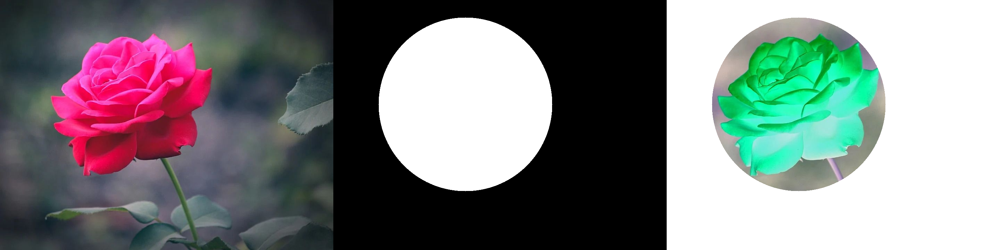

In [ ]:
img_t = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')

mask = np.zeros(img_t.shape, dtype=np.uint8)
mask1 = cv.circle(mask, (380, 300), 250, (255,255,255), -1)

result = ~(img_t & mask1)  # menggunakan operator bitwise NAND

final_frame = cv.hconcat((img_t, mask, result))
cv2_imshow(final_frame)

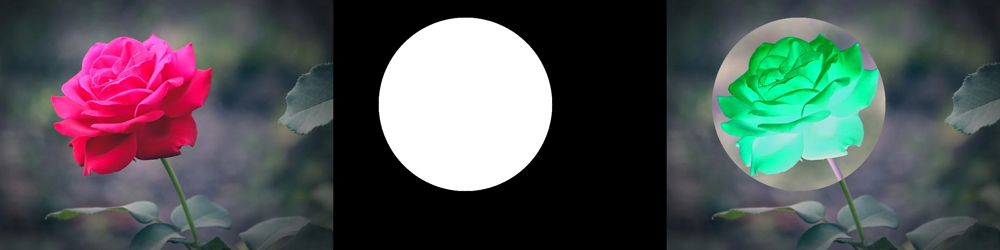

In [ ]:
img_t = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')

mask = np.zeros(img_t.shape, dtype=np.uint8)
mask1 = cv.circle(mask, (380, 300), 250, (255,255,255), -1)

result = img_t ^ mask1  # menggunakan operator bitwise XOR pada gambar input dan mask1

final_frame = cv.hconcat((img_t, mask, result))
cv2_imshow(final_frame)

**Image Histogram**

<BarContainer object of 256 artists>

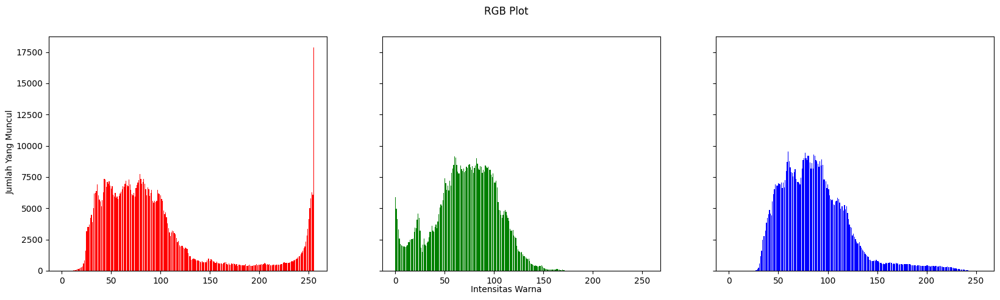

In [ ]:
img_2 = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')
height, width, depth = np.shape(img_2)
names = np.arange(256)

blue = [0]*256
green = [0]*256
red = [0]*256

for y in range(0,height):
  for x in range(0, width):
    blue[img_2[y][x][0]] += 1
    green[img_2[y][x][1]] += 1
    red[img_2[y][x][2]] += 1

names = np.arange(256)
fig, axs = plt.subplots(1, 3, figsize=[20, 5], sharex=True, sharey=True)
fig.suptitle('RGB Plot')
fig.text(0.09, 0.5, 'Jumlah Yang Muncul', va='center', rotation='vertical')
fig.text(0.5, 0.04, 'Intensitas Warna', ha='center')
axs[0].bar(names, red, color='red')
axs[1].bar(names, green, color='green')
axs[2].bar(names, blue, color='blue')

**Image Hisotgram dengan Numpy**

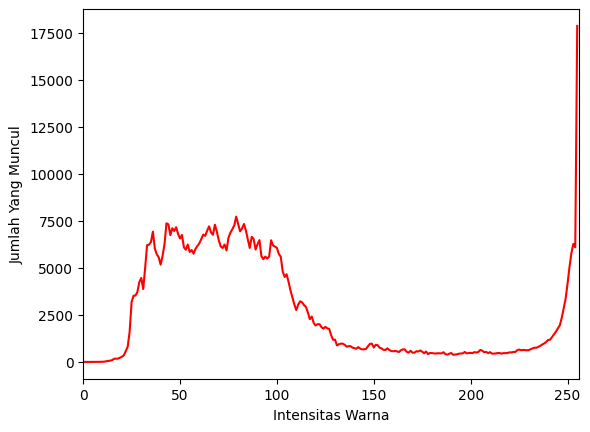

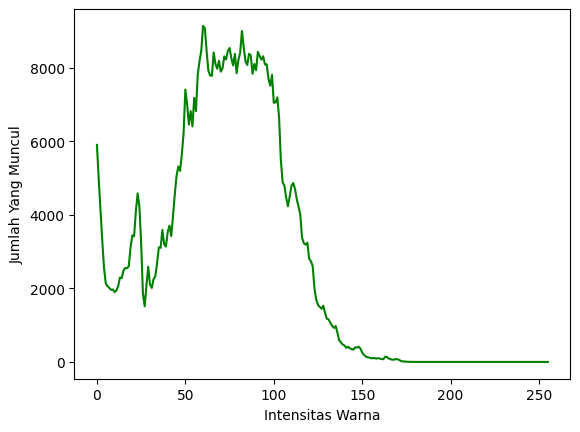

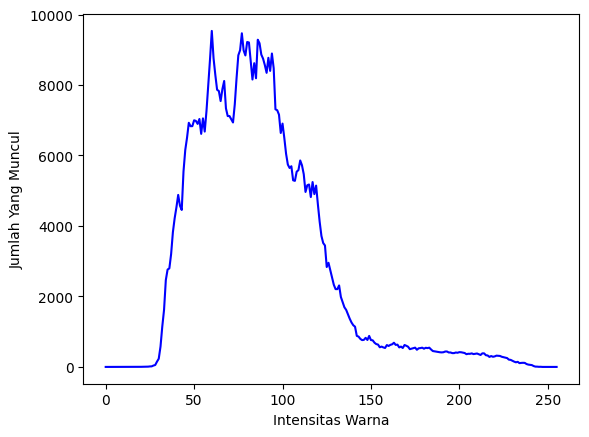

In [ ]:
from numpy.lib.histograms import histogram
colors = ("r", "g", "b")
channel_ids = (2, 1, 0)

plt.xlim([0,256])
for channel_id, c in zip(channel_ids, colors):
  histogram, bin_edges = np.histogram(
      img_2[:, :, channel_id], bins=256, range=(0,256)
  )
  plt.plot(bin_edges[0:-1], histogram, color=c)

  plt.xlabel("Intensitas Warna")
  plt.ylabel("Jumlah Yang Muncul")

  plt.show()
  plt.show()

**Histogram yang menyerupai histogram equalization**

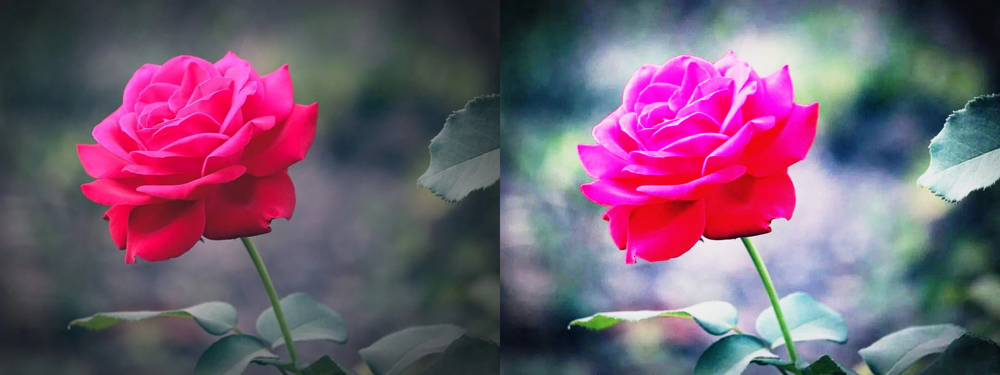

<BarContainer object of 256 artists>

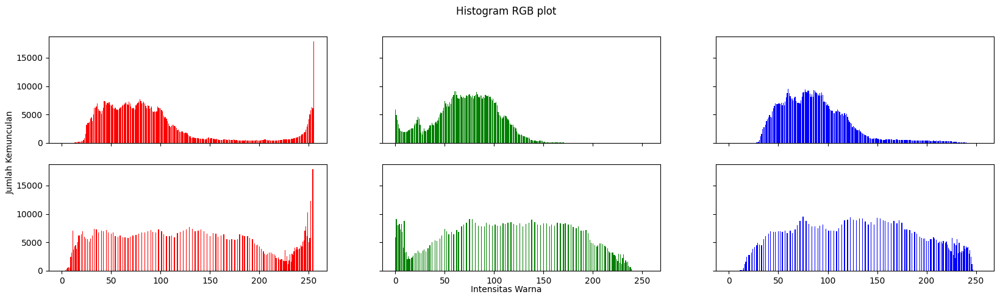

In [ ]:
img_3 = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg') 
height, width, depth = np.shape(img_3)
names = np.arange(256)

blue = [0]*256
green = [0]*256
red = [0]*256

def histog(img_3):
  height, width, depth = np.shape(img_3) 
  ax = np.zeros((3,256)) 
  for y in range(0,height) : 
    for x in range(0,width) :
      ax[0][img_3[y][x][0]] += 1 
      ax[1][img_3[y][x][1]] += 1
      ax[2][img_3[y][x][2]] += 1 
  return ax

histo_asli = histog(img_3)

img_array = np.asarray(img_3)


histogram_array = np.bincount(img_array.flatten(), minlength=256)

num_pixels = np. sum(histogram_array) 
histogram_array = histogram_array/num_pixels
chistogram_array = np.cumsum(histogram_array)
transform_map = np.floor(255 * chistogram_array). astype (np.uint8)
img_list = list(img_array.flatten())
eq_img_list = [transform_map[p] for p in img_list]
eq_img_array = np.reshape(np.asarray(eq_img_list), img_array.shape) 
img_4 = eq_img_array
equal_histo = histog(img_4)
final_frame = cv.hconcat((img_3, img_4)) 
cv2_imshow(final_frame)

names = np.arange (256) 
fig, axs = plt.subplots(2, 3, figsize=[20,5], sharex=True, sharey=True) 
fig.suptitle('Histogram RGB plot') 
fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical') 
fig.text(0.5, 0.04, 'Intensitas Warna', ha='center') 
axs[0,0].bar(names, histo_asli[2], color='red') 
axs[0,1].bar(names, histo_asli[1], color='green') 
axs[0,2].bar(names, histo_asli[0], color='blue') 
axs[1,0].bar(names, equal_histo[2], color='red') 
axs[1,1].bar(names, equal_histo[1], color='green')
axs[1,2].bar(names, equal_histo[0], color='blue')

EqualizeHist

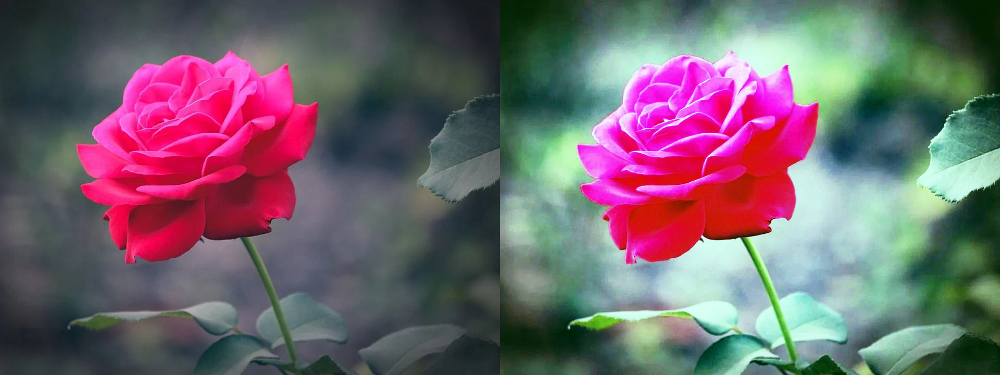

<BarContainer object of 256 artists>

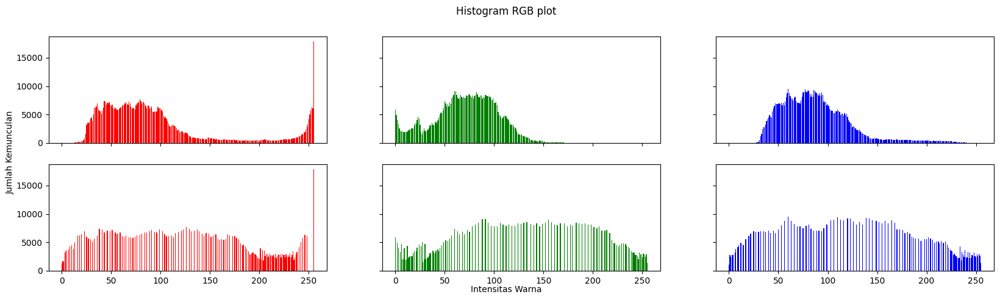

In [ ]:
img_5 = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg')

def histog(img1):
  height, width, depth = np.shape(img1)
  ax = np.zeros((3,256))
  for h in range(0,height):
    for w in range(0,width):
      ax[0][img1[h][w][0]] += 1
      ax[1][img1[h][w][1]] += 1
      ax[2][img1[h][w][2]] += 1
  return ax

histo_asli = histog(img_5)

channels = cv.split(img_5)
eq_channels = []
for ch, color in zip(channels, ['R', 'G', 'B']):
  eq_channels.append(cv.equalizeHist(ch))
eq_image = cv.merge(eq_channels)
equal_histo = histog(eq_image)

final_frame = cv.hconcat((img_5, eq_image))
cv2_imshow(final_frame)

height, width, depth = np.shape(img_5)
names = np.arange(256)

blue = [0]*256
green = [0]*256
red = [0]*256

names = np.arange(256)
fig, axs = plt.subplots(2, 3, figsize=[20,5], sharex=True, sharey =True)
fig.suptitle('Histogram RGB plot')
fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical')
fig.text(0.5, 0.04, 'Intensitas Warna', ha='center')
axs[0,0].bar(names, histo_asli[2], color='red')
axs[0,1].bar(names, histo_asli[1], color='green')
axs[0,2].bar(names, histo_asli[0], color='blue')
axs[1,0].bar(names, equal_histo[2], color='red')
axs[1,1].bar(names, equal_histo[1], color='green')
axs[1,2].bar(names, equal_histo[0], color='blue')

Mapping 16 juta ke 8 warna

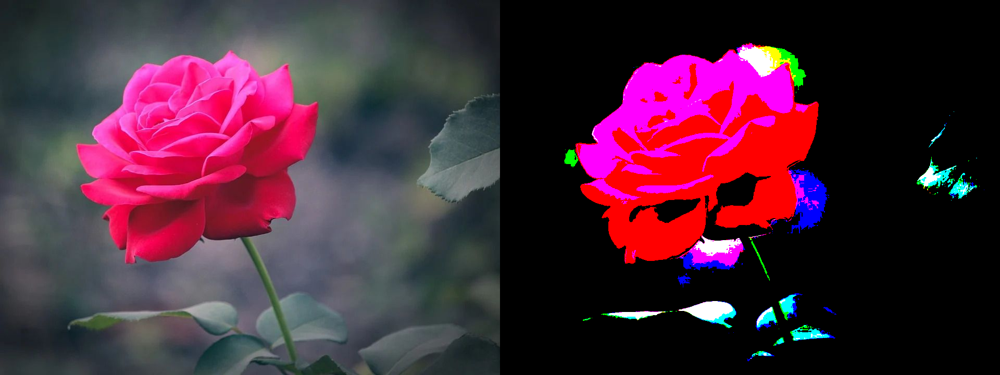

In [ ]:
mawar_original = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar1.jpg')

def warnaTerdekat (r, g, b):
  pValue = 0
  minDistance = 255*255 + 255*255 + 255*255 + 1
  warnaPallette = [[0, 0, 0], [255, 0, 0], [0, 255, 0], [255, 255, 0], [0, 0, 255], [255, 0, 255], [0, 255, 255], [255, 255, 255]]
  for i in range(len(warnaPallette)):
    rDiff = r - warnaPallette[i][0]
    gDiff = g - warnaPallette[i][1]
    bDiff = b - warnaPallette[i][2]
    distance = rDiff*rDiff + gDiff*gDiff + bDiff*bDiff
    if (distance < minDistance):
      minDistance = distance
      pValue = i
  return pValue

warnaPallette = [[0, 0, 0], [255, 0, 0], [0, 255, 0], [255, 255, 0], [0, 0, 255], [255, 0, 255], [0, 255, 255], [255, 255, 255]]
img_16jt = cv.cvtColor(mawar_original, cv.COLOR_BGR2RGB)
img_8 = np.zeros(img_16jt.shape, img_16jt.dtype)

for y in range(0, img_16jt.shape[0]):
  for x in range(0, img_16jt.shape[1]):
    baru = warnaTerdekat(img_16jt[y, x, 0], img_16jt[y, x, 1], img_16jt[y, x, 2])
    img_8[y, x] = warnaPallette[baru]
    
img_16jt = cv.cvtColor(img_16jt, cv.COLOR_BGR2RGB)
img_8 = cv.cvtColor(img_8, cv.COLOR_BGR2RGB)
final_frame = cv.hconcat((img_16jt, img_8))
cv2_imshow(final_frame)

**Dhitering Floyd and Steinberg**

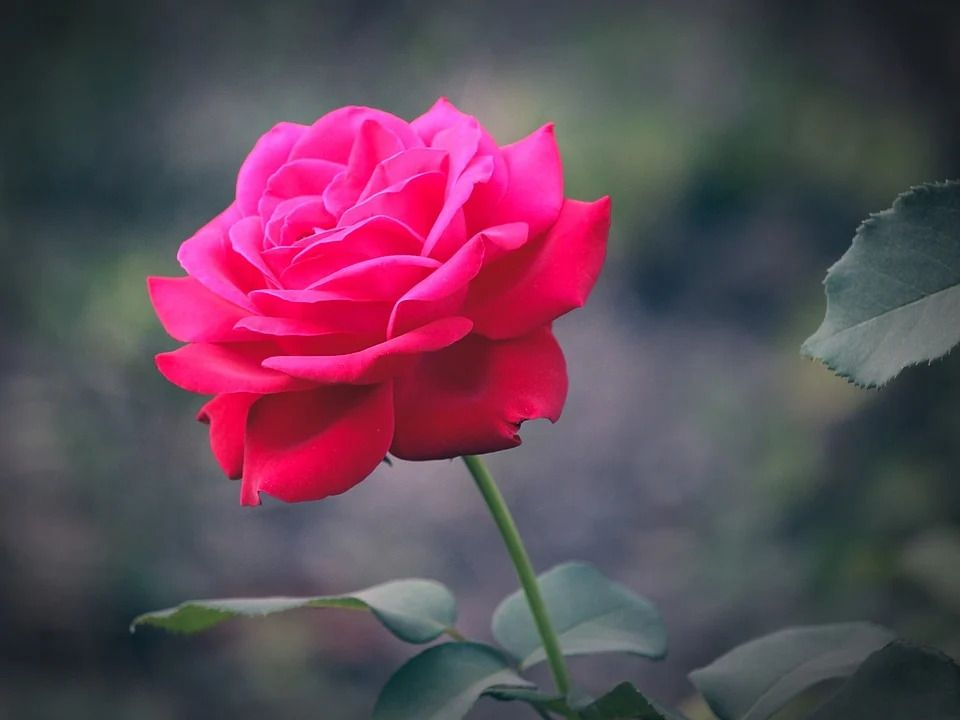

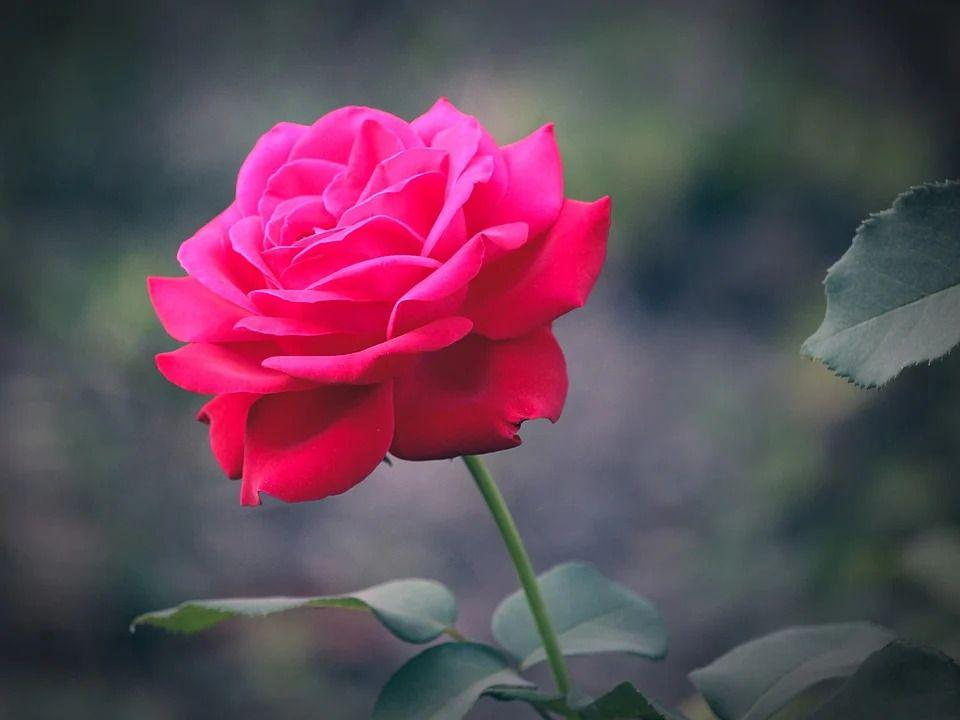

In [ ]:
from PIL import Image

# Load image and convert it to RGB using Floyd-Steinberg dithering
imageConvert = Image.open('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar1.jpg').convert(mode='RGB', dither=Image.FLOYDSTEINBERG)
imageConvert.save('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_save.jpg')

# Load the original image
ImageOriginal = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar1.jpg')

# Load the dithered image
ImageDithered = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_save.jpg')

# Display the original and dithered images
cv2_imshow(ImageOriginal)
cv2_imshow(ImageDithered)

Convert dari image lena_lc ke grayscale <PIL.Image.Image image mode=1 size=960x720 at 0x7F96BF9ED520>
Hasil Dithering dengan jarak tetangga 1 pixel


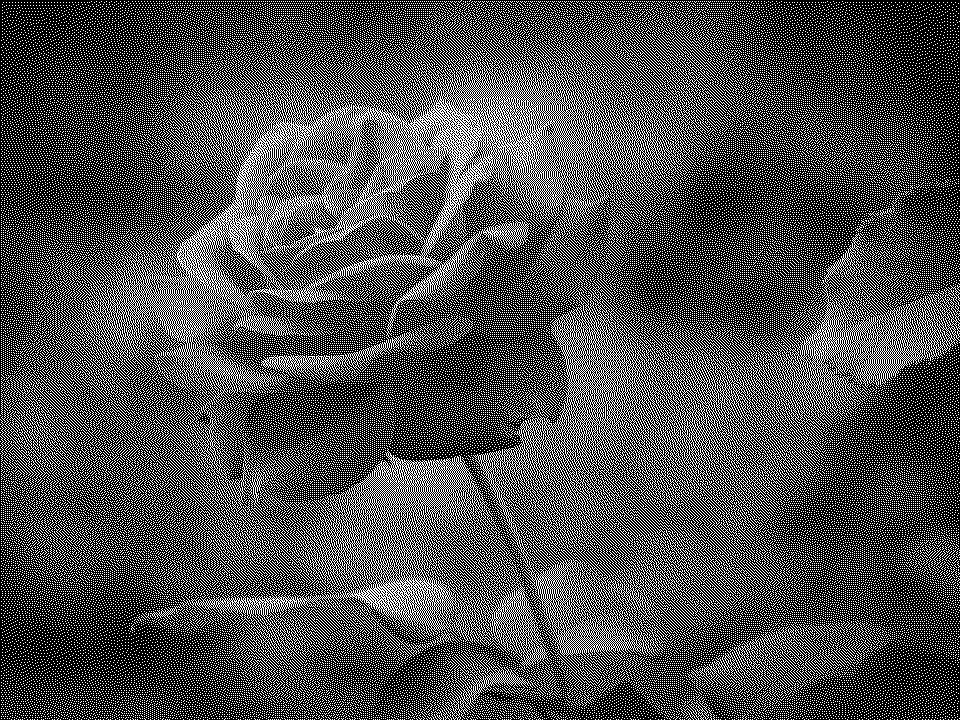

In [ ]:
from PIL import Image
import cv2

imageWiki = Image.open('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg').convert(mode='1',dither=Image.FLOYDSTEINBERG)
imageWiki.save('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_savelagi.jpg')


Image = cv2.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg')
Image2 = cv2.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg')
image_2 = cv.cvtColor(Image2, cv.COLOR_BGR2RGB)

FloydSteinberg = cv2.cvtColor(Image, cv2.COLOR_BGR2GRAY)
cv2.imwrite('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg', FloydSteinberg)

img_gray = print('Convert dari image lena_lc ke grayscale', imageWiki)

# implementasikan proses dithering Floyd and Steinberg
Height = FloydSteinberg.shape[0]
Width = FloydSteinberg.shape[1]

for y in range(0, Height):
    for x in range(0, Width):

        old_value = FloydSteinberg[y, x]
        new_value = 0
        if (old_value > 128) :
            new_value = 255

        FloydSteinberg[y, x] = new_value

        Error = old_value - new_value

        if (x<Width-1):
            NewNumber = FloydSteinberg[y, x+1] + Error * 7 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y, x+1] = NewNumber

        if (x>0 and y<Height-1):
            NewNumber = FloydSteinberg[y+1, x-1] + Error * 3 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y+1, x-1] = NewNumber

        if (y<Height-1):
            NewNumber= FloydSteinberg[y+1, x] + Error * 5 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y+1, x] = NewNumber

        if (y<Height-1 and x<Width-1):
            NewNumber = FloydSteinberg[y+1, x+1] + Error * 1 / 16
            if (NewNumber>255) : NewNumber=255
            elif (NewNumber<0) : NewNumber=0
            FloydSteinberg[y+1, x+1] = NewNumber
            FloydSteinberg[y+1, x+1] = NewNumber

# cv2.imshow(Image)
cv2.imwrite('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar_lc.jpg', FloydSteinberg)
print('Hasil Dithering dengan jarak tetangga 1 pixel')
cv2_imshow(FloydSteinberg)

Konvolusi tanpa library

In [ ]:
#Mendefinisikan fungsi convolution2d yang menerima parameter gambar (image), kernel, stride, dan padding.
def convolution2d(image, kernel, stride, padding):

#Melakukan padding pada gambar dengan menggunakan nilai padding yang diberikan dan nilai piksel yang konstan (0) pada area yang dipadding.
  image = np.pad(image, padding, mode='constant', constant_values=0)

#Mengambil dimensi dari kernel dan gambar yang telah dipadding.
  kernel_height, kernel_width = kernel.shape
  padded_height, padded_width = image.shape

#Menghitung dimensi dari gambar hasil konvolusi berdasarkan tinggi (output_height) dan lebar (output_width) gambar yang telah dipadding dan kernel yang digunakan.
  output_height = (padded_height - kernel_height) // stride + 1
  output_width = (padded_width - kernel_width) // stride + 1

#Membuat array baru yang berisi nol dengan dimensi hasil konvolusi dan tipe data float32.
  new_image = np.zeros((output_height, output_width)).astype(np.float32)

#Melakukan konvolusi pada gambar dengan kernel yang telah ditentukan dan stride yang telah diberikan pada setiap posisi kernel. Kemudian, hasil konvolusi disimpan pada array new_image.
  for y in range(0, output_height):
    for x in range(0, output_width):
      new_image[y][x] = np.sum(image[y * stride:y * stride + kernel_height, x * stride:x * stride + kernel_width] * kernel).astype(np.float32)

 #Mengembalikan hasil gambar hasil konvolusi yang telah diproses menggunakan kernel dan parameter yang telah ditentukan.     
  return new_image

In [ ]:
img_1 = cv.imread('/content/drive/MyDrive/Pengolahan Citra/UTS/bunga-mawar.jpg')
img_gray = cv.cvtColor(img_1, cv.COLOR_BGR2GRAY)

Sherpen

In [ ]:
kernel_sharpen = np.array([[0,-1,0],
                           [-1,5,-1],
                           [0,-1,0]])

SHARPEN


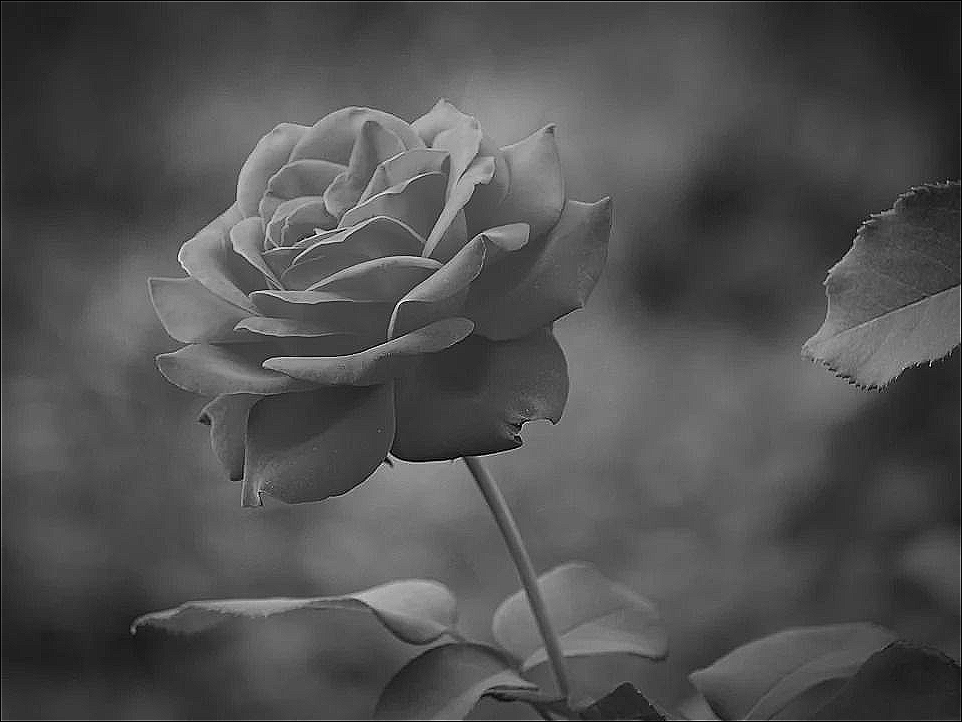

In [ ]:
print("SHARPEN")
cv2_imshow(convolution2d(img_gray, kernel_sharpen, 1, 2))

Emboss

In [ ]:
kernel_emboss = np.array([[-2,-1,0],
                          [-1,1,1],
                          [0,1,2]])

EMBOSS


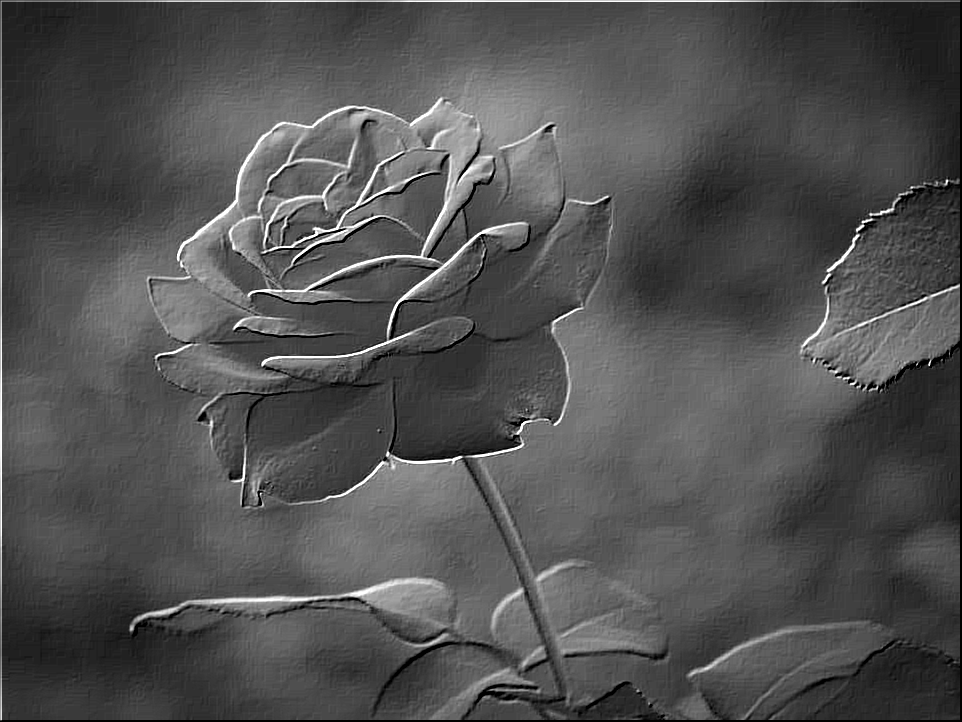

In [ ]:
print("EMBOSS")
cv2_imshow(convolution2d(img_gray, kernel_emboss, 1, 2))

Left Sobel Edge Detection

In [ ]:
kernel_sobel = np.array([[1,0,-1],
                         [2,0,-2],
                         [1,0,-1]])

LEFT SOBEL EDGE DETECTION


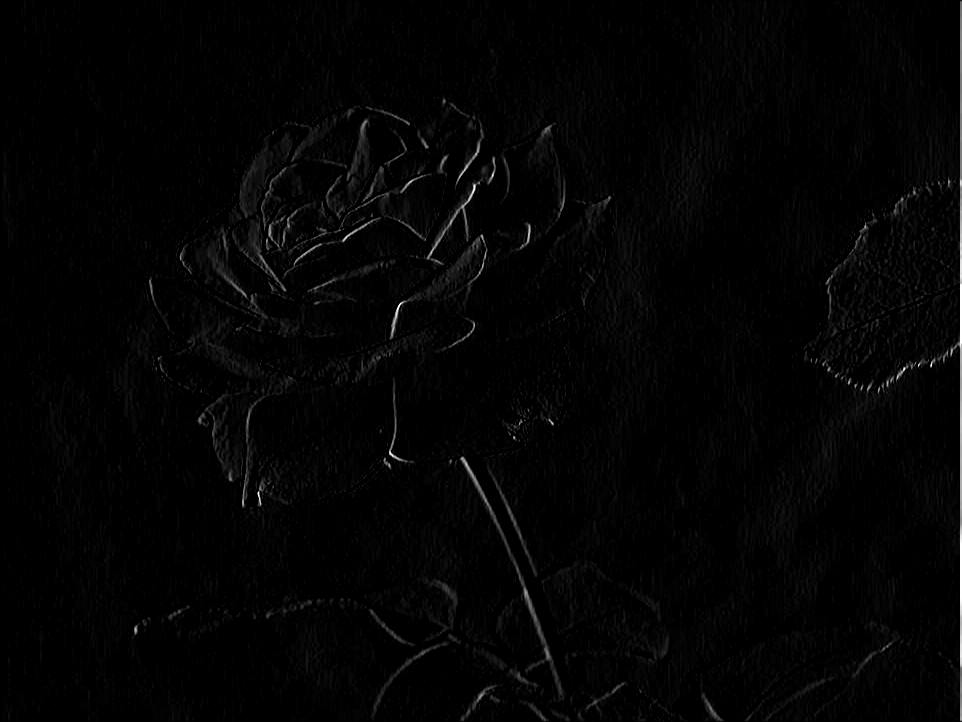

In [ ]:
print("LEFT SOBEL EDGE DETECTION")
cv2_imshow(convolution2d(img_gray, kernel_sobel, 1, 2))

Canny Edge Detection

CANNY EDGE DETECTION


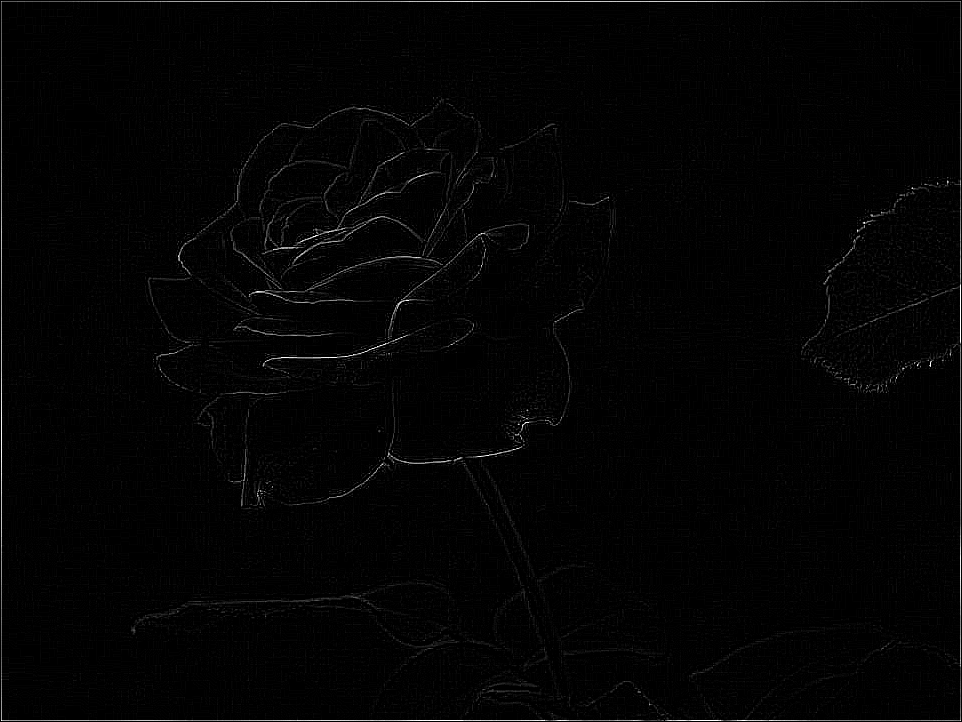

In [ ]:
kernel_canny = np.array([[-1,-1,-1],
                         [-1,8,-1],
                         [-1,-1,-1]])
print("CANNY EDGE DETECTION")
cv2_imshow(convolution2d(img_gray, kernel_canny, 1, 2))

21 x 21 Gaussian Blur

21x21 GAUSSIAN BLUR


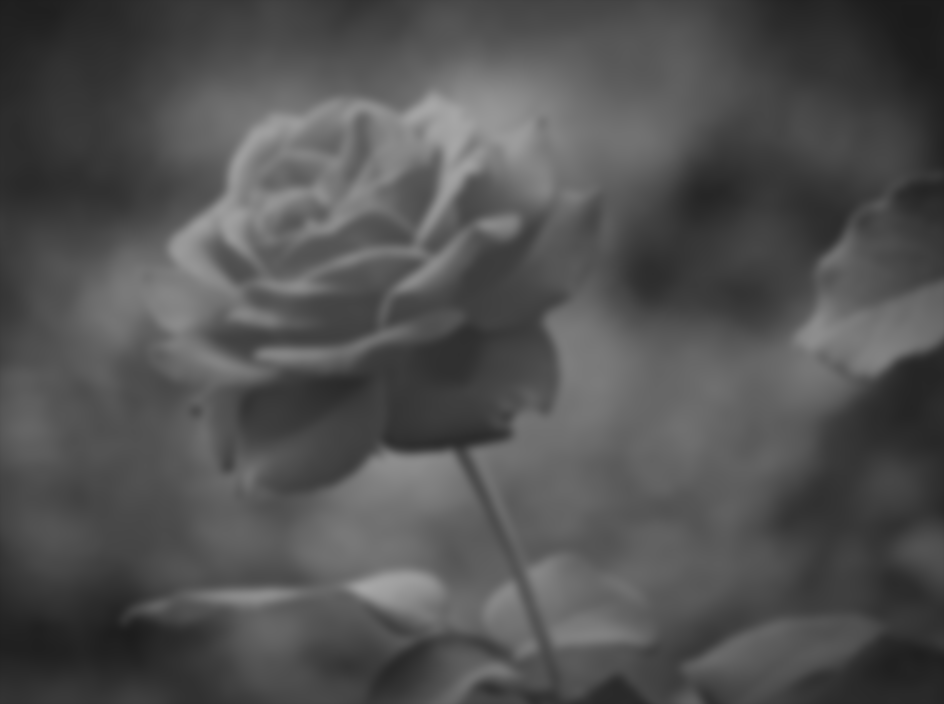

In [ ]:
kernel_size = 21
sigma = math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
gauss_kernel = gaussian_kernel @ gaussian_kernel.transpose()

print("21x21 GAUSSIAN BLUR")
cv2_imshow(convolution2d(img_gray, gauss_kernel, 1, 2))